>Uncomment to install imports

In [127]:
#! pip install -U scikit-learn
#! pip install folium
#! pip install matplotlib
#! pip install shapely

In [128]:
import folium
import pandas as pd
import requests
import csv
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

## Creating Average Income after Tax Dataframe

We first start by reading the dataset for Neighbourhood Profiles of 2016 into a pandas dataframe, 'dfNeighbour". Due to the formatting of this dataset, we must transpose the data such that it shows all of the neighbourhoods in an "x axis". The '_id', 'Category' and 'Data Source' values are then dropped, as they did not provide us with useful information.

To locate the average income after tax, we query the dataframe for the index number of the specified data title. We then perform several operations to sanitize the data, including converting the values to integers and 


In [129]:
dfNeighbour = pd.read_csv('neighbourhood-profiles-2016.csv')
dfNeighbour = dfNeighbour.transpose().drop(["_id","Category","Data Source"])
dfNeighbour

# CHANGED TO AVERAGE INCOME AFTER TAX
indexNum = 0
for i in range(len(dfNeighbour.columns)):
    if dfNeighbour[i]["Characteristic"] == "  Average after-tax income of households in 2015 ($)":
        indexNum = i

#Build dataframe
avgIncome = dfNeighbour[[0,indexNum]].drop(["Topic","Characteristic","City of Toronto"])
avgIncome = avgIncome.replace(',','', regex=True)
c = avgIncome.select_dtypes(object).columns
avgIncome[c] = avgIncome[c].apply(pd.to_numeric,errors='coerce')

avgIncome.rename(columns = {0:'Neigbourhood_ID', 1029:'avgIncomeHousehold'}, inplace = True)


avgIncome


,Neigbourhood_ID,avgIncomeHousehold
Agincourt North,129,427037
Agincourt South-Malvern West,128,278390
Alderwood,20,168602
Annex,95,792507
Banbury-Don Mills,42,493486
...,...,...
Wychwood,94,239484
Yonge-Eglinton,100,222648
Yonge-St.Clair,97,541217
York University Heights,27,302358


## Crime Rates Dataframe

In [130]:
dfCrime = pd.read_csv('Neighbourhood_Crime_Rates.csv')

#CHANGED TO AVERAGE CRIME IN NEIGHBOURHOOD
columnList = ["Neighbourhood","Hood_ID","Assault_AVG","AutoTheft_AVG","BreakandEnter_AVG","Homicide_AVG","Robbery_AVG","TheftOver_AVG"]
dfCrime = dfCrime[columnList]
dfCrime['AVG_Crime'] = dfCrime.drop('Hood_ID', axis=1).mean(axis=1)
dfCrimeTotal = dfCrime[["Hood_ID",'AVG_Crime']]
dfCrimeTotal

C:\Users\saash\AppData\Local\Temp/ipykernel_15048/3522191696.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  dfCrime['AVG_Crime'] = dfCrime.drop('Hood_ID', axis=1).mean(axis=1)


,Hood_ID,AVG_Crime
0,97,11.433333
1,27,110.933333
2,38,26.100000
3,31,55.700000
4,16,31.900000
...,...,...
135,130,50.000000
136,46,15.850000
137,94,22.300000
138,56,16.200000


## Age Dataframe

In [131]:
indexNum = 0
for i in range(len(dfNeighbour.columns)):
    if dfNeighbour[i]["Characteristic"] == "Working Age (25-54 years)":
        indexNum = i
dfNeighbour

age = dfNeighbour[[0,indexNum]].drop(["Topic","Characteristic","City of Toronto"])
age = age.replace(',','', regex=True)
c = age.select_dtypes(object).columns
age[c] = age[c].apply(pd.to_numeric,errors='coerce')

age.rename(columns = {0:'Neigbourhood_ID', 11:'workingAgeIncome'}, inplace = True)

age



,Neigbourhood_ID,workingAgeIncome
Agincourt North,129,11305
Agincourt South-Malvern West,128,9965
Alderwood,20,5220
Annex,95,15040
Banbury-Don Mills,42,10810
...,...,...
Wychwood,94,6420
Yonge-Eglinton,100,5860
Yonge-St.Clair,97,5960
York University Heights,27,12290


In [132]:
geoJSON = "./Neighbourhoods.geojson"

criminalHeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='Crime', 
    columns = ['Hood_ID', 'AVG_Crime'],
    data=dfCrime,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='YlOrRd',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "Average Neighbourhood Crime"
)

wealthHeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='Income', 
    columns = ['Neigbourhood_ID', 'avgIncomeHousehold'],
    data=avgIncome,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='YlGnBu',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "Average after-tax income of households in 2015"
)

ageHeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='Age', 
    columns = ['Neigbourhood_ID', 'workingAgeIncome'],
    data=age,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='PuBuGn',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "Working Age (25-54 years)"
)

# Creating borders for neighbourhoods
newMap = folium.GeoJson(geoJSON, name="geojson")
m = folium.Map(location=[43.6532, -79.3832],
           zoom_start=12,           
           attr='My Data Attribution').add_child(newMap).add_child(criminalHeatMap).add_child(wealthHeatMap).add_child(ageHeatMap).add_child(folium.LayerControl())

m

In [133]:
url = "https://api.foursquare.com/v3/places/search?query=starbucks&ll=43.73%2C-79.41&radius=100000&limit=50"
url2 = "https://api.foursquare.com/v3/places/search?query=starbucks&ll=43.776%2C-79.231&radius=100000&limit=50"
url3 = "https://api.foursquare.com/v3/places/search?query=starbucks&ll=43.6205%2C-79.51321&radius=100000&limit=50"
url4 = "https://api.foursquare.com/v3/places/search?query=starbucks&ll=43.7064%2C-79.5634&radius=100000&limit=50"

url5 = "https://api.foursquare.com/v3/places/search?query=tim%20hortons&ll=43.73%2C-79.41&radius=100000&limit=50"
url6 = "https://api.foursquare.com/v3/places/search?query=tim%20hortons&ll=43.776%2C-79.231&radius=100000&limit=50"
url7 = "https://api.foursquare.com/v3/places/search?query=tim%20hortons&ll=43.6205%2C-79.51321&radius=100000&limit=50"
url8 = "https://api.foursquare.com/v3/places/search?query=tim%20hortons&ll=43.7064%2C-79.5634&radius=100000&limit=50"

headers = {
    "Accept": "application/json",
    "Authorization": "fsq3GxFNS8ebA8RbiUxLAb0QXXbCEKCH/Junx4qaSX5DN2c="
}

response = requests.request("GET", url, headers=headers)
response2 = requests.request("GET", url2, headers=headers)
response3 = requests.request("GET", url3, headers=headers)
response4 = requests.request("GET", url4, headers=headers)

response5 = requests.request("GET", url5, headers=headers)
response6 = requests.request("GET", url6, headers=headers)
response7 = requests.request("GET", url7, headers=headers)
response8 = requests.request("GET", url8, headers=headers)

starbucksList = response.json()
starbucksList2 = response2.json()
starbucksList3 = response3.json()
starbucksList4 = response4.json()

timhortonsList = response5.json()
timhortonsList2 = response6.json()
timhortonsList3 = response7.json()
timhortonsList4 = response8.json()

f = open('coordinates.csv', 'w')
writer = csv.writer(f)

def marker(coffeeList,mapName):
    for i in range(len(coffeeList["results"])):
        folium.CircleMarker(
        location=[coffeeList["results"][i]["geocodes"]["main"]["latitude"], coffeeList["results"][i]["geocodes"]["main"]["longitude"]],
        radius=5,
        popup="Starbucks",
    color="#7CFC00",
    fill=True,
    fill_color="#7CFC00",
        ).add_to(mapName)
        if mapName == m:
            writer.writerow([coffeeList["results"][i]["geocodes"]["main"]["latitude"], coffeeList["results"][i]["geocodes"]["main"]["longitude"]])

def marker2(coffeeList,mapName):
    for i in range(len(coffeeList["results"])):
        folium.CircleMarker(
        location=[coffeeList["results"][i]["geocodes"]["main"]["latitude"], coffeeList["results"][i]["geocodes"]["main"]["longitude"]],
        radius=5,
        popup="Tim Hortons",
    color="#FF0E0E",
    fill=True,
    fill_color="#FF0E0E",
        ).add_to(mapName)
        if mapName == m:
            writer.writerow([coffeeList["results"][i]["geocodes"]["main"]["latitude"], coffeeList["results"][i]["geocodes"]["main"]["longitude"]])

marker(starbucksList,m)
marker(starbucksList2,m)
marker(starbucksList3,m)
marker(starbucksList4,m)
marker2(timhortonsList,m)
marker2(timhortonsList2,m)
marker2(timhortonsList3,m)
marker2(timhortonsList4,m)

f.close()
m

## Creating Final Dataframe

In [134]:
exec(open("test.py").read())
numCoffeeShop = pd.read_csv('areaCodeNum.csv')

numCoffeeShop


dfFinal = numCoffeeShop.merge(dfCrimeTotal, how='left', left_on='Neighbourhood_ID', right_on='Hood_ID').merge(avgIncome, how='left', left_on='Hood_ID', right_on='Neigbourhood_ID').merge(age,how='left', left_on='Hood_ID', right_on='Neigbourhood_ID')
dfFinal = dfFinal[['Neighbourhood_ID','Number_CoffeeShop','AVG_Crime','avgIncomeHousehold','workingAgeIncome']]

#dfFinal = dfFinal[(dfFinal != 0).all(1)]


dfFinal

,Neighbourhood_ID,Number_CoffeeShop,AVG_Crime,avgIncomeHousehold,workingAgeIncome
0,96,1,13.316667,545338,4555
1,95,12,81.100000,792507,15040
2,109,0,18.833333,132879,4570
3,64,0,24.450000,240272,6165
4,103,2,17.433333,1216585,5870
...,...,...,...,...,...
135,126,7,58.666667,251476,10485
136,133,0,14.166667,215135,5030
137,22,1,42.300000,184459,6445
138,37,3,28.783333,272986,7480


## Cluster 1: Coffee Shops v.s Average Crime

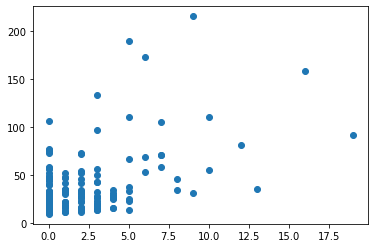

In [135]:
dfCluster1 = dfFinal[['Number_CoffeeShop','AVG_Crime']]
plot1 = plt.scatter(dfCluster1['Number_CoffeeShop'], dfCluster1['AVG_Crime'])


In [136]:
km1 = KMeans(n_clusters = 4)
predicted1 = km1.fit_predict(dfCluster1)
dfCluster1['cluster'] = predicted1
dfCluster1


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/488559568.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster1['cluster'] = predicted1


,Number_CoffeeShop,AVG_Crime,cluster
0,1,13.316667,0
1,12,81.100000,3
2,0,18.833333,0
3,0,24.450000,0
4,2,17.433333,0
...,...,...,...
135,7,58.666667,2
136,0,14.166667,0
137,1,42.300000,2
138,3,28.783333,0


# CLUSTER 1 WITHOUT FITTING

Text(0, 0.5, 'Average Neighbourhood Crime')

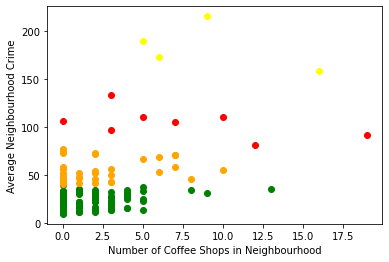

In [137]:
df1Cluster1 = dfCluster1[dfCluster1.cluster == 0]
df2Cluster1 = dfCluster1[dfCluster1.cluster == 1]
df3Cluster1 = dfCluster1[dfCluster1.cluster == 2]
df4Cluster1 = dfCluster1[dfCluster1.cluster == 3]

plt.scatter(df1Cluster1.Number_CoffeeShop,df1Cluster1.AVG_Crime, color = 'green')
plt.scatter(df2Cluster1.Number_CoffeeShop,df2Cluster1.AVG_Crime, color = 'yellow')
plt.scatter(df3Cluster1.Number_CoffeeShop,df3Cluster1.AVG_Crime, color = 'orange')
plt.scatter(df4Cluster1.Number_CoffeeShop,df4Cluster1.AVG_Crime, color = 'red')

plt.xlabel('Number of Coffee Shops in Neighbourhood')
plt.ylabel('Average Neighbourhood Crime')

# CLUSTER 1 WITH FITTING

In [138]:
scaler = MinMaxScaler()
scaler.fit(dfCluster1[['Number_CoffeeShop']])
scaler.fit(dfCluster1[['AVG_Crime']])
dfCluster1['Number_CoffeeShop'] = abs(scaler.transform(dfCluster1[['Number_CoffeeShop']]))
dfCluster1['AVG_Crime'] = scaler.transform(dfCluster1[['AVG_Crime']])

dfCluster1

C:\Users\saash\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Number_CoffeeShop
Feature names seen at fit time, yet now missing:
- AVG_Crime

  warnings.warn(message, FutureWarning)
C:\Users\saash\AppData\Local\Temp/ipykernel_15048/1431504931.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster1['Number_CoffeeShop'] = abs(scaler.transform(dfCluster1[['Number_CoffeeShop']]))
C:\Users\saash\AppData\Local\Temp/ipykernel_15048/1431504931.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = val

,Number_CoffeeShop,AVG_Crime,cluster
0,0.042808,0.017107,0
1,0.010702,0.346846,3
2,0.047673,0.043944,0
3,0.047673,0.071266,0
4,0.037944,0.037133,0
...,...,...,...
135,0.013621,0.237717,2
136,0.047673,0.021242,0
137,0.042808,0.158100,2
138,0.033079,0.092346,0


In [139]:
predicted1 = km1.fit_predict(dfCluster1)
dfCluster1['cluster'] = predicted1
dfCluster1

C:\Users\saash\AppData\Local\Temp/ipykernel_15048/2699154658.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster1['cluster'] = predicted1


,Number_CoffeeShop,AVG_Crime,cluster
0,0.042808,0.017107,1
1,0.010702,0.346846,2
2,0.047673,0.043944,1
3,0.047673,0.071266,1
4,0.037944,0.037133,1
...,...,...,...
135,0.013621,0.237717,0
136,0.047673,0.021242,1
137,0.042808,0.158100,0
138,0.033079,0.092346,1


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/200107797.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster1['hood'] = dfFinal['Neighbourhood_ID']


,Number_CoffeeShop,AVG_Crime,cluster,hood
0,0.042808,0.017107,1,96
1,0.010702,0.346846,2,95
2,0.047673,0.043944,1,109
3,0.047673,0.071266,1,64
4,0.037944,0.037133,1,103
...,...,...,...,...
135,0.013621,0.237717,0,126
136,0.047673,0.021242,1,133
137,0.042808,0.158100,0,22
138,0.033079,0.092346,1,37


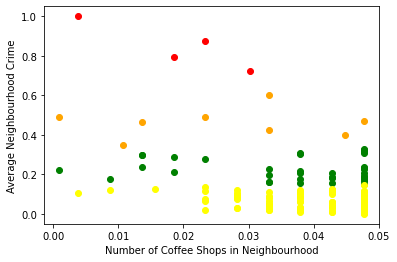

In [140]:
df1Cluster1 = dfCluster1[dfCluster1.cluster == 0]
df2Cluster1 = dfCluster1[dfCluster1.cluster == 1]
df3Cluster1 = dfCluster1[dfCluster1.cluster == 2]
df4Cluster1 = dfCluster1[dfCluster1.cluster == 3]

plt.scatter(df1Cluster1.Number_CoffeeShop,df1Cluster1.AVG_Crime, color = 'green')
plt.scatter(df2Cluster1.Number_CoffeeShop,df2Cluster1.AVG_Crime, color = 'yellow')
plt.scatter(df3Cluster1.Number_CoffeeShop,df3Cluster1.AVG_Crime, color = 'orange')
plt.scatter(df4Cluster1.Number_CoffeeShop,df4Cluster1.AVG_Crime, color = 'red')

plt.xlabel('Number of Coffee Shops in Neighbourhood')
plt.ylabel('Average Neighbourhood Crime')

dfCluster1['hood'] = dfFinal['Neighbourhood_ID']

dfCluster1

## CLUSTER 2: Coffee Shops v.s Average after-tax income of households in 2015

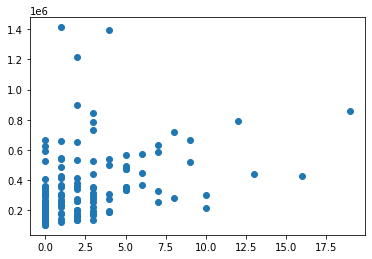

In [141]:
dfCluster2 = dfFinal[['Number_CoffeeShop','avgIncomeHousehold']]

plt.scatter(dfCluster2['Number_CoffeeShop'], dfCluster2['avgIncomeHousehold'])


In [142]:
km2 = KMeans(n_clusters = 3)
predicted2 = km2.fit_predict(dfCluster2)

dfCluster2['cluster'] = predicted2

scaler.fit(dfCluster2[['Number_CoffeeShop']])
scaler.fit(dfCluster2[['avgIncomeHousehold']])
dfCluster2['Number_CoffeeShop'] = abs(scaler.transform(dfCluster2[['Number_CoffeeShop']]))
dfCluster2['avgIncomeHousehold'] = abs(scaler.transform(dfCluster2[['avgIncomeHousehold']]))
dfCluster2

C:\Users\saash\AppData\Local\Temp/ipykernel_15048/2714135270.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster2['cluster'] = predicted2
C:\Users\saash\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Number_CoffeeShop
Feature names seen at fit time, yet now missing:
- avgIncomeHousehold

  warnings.warn(message, FutureWarning)
C:\Users\saash\AppData\Local\Temp/ipykernel_15048/2714135270.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentatio

,Number_CoffeeShop,avgIncomeHousehold,cluster
0,0.078008,0.338003,2
1,0.077999,0.526556,2
2,0.078008,0.023358,0
3,0.078008,0.105283,0
4,0.078007,0.850064,1
...,...,...,...
135,0.078003,0.113830,0
136,0.078008,0.086108,0
137,0.078008,0.062706,0
138,0.078006,0.130239,0


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/226999512.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster2['hood'] = dfFinal['Neighbourhood_ID']


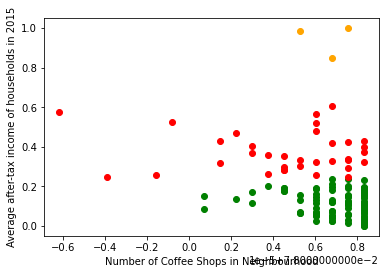

In [143]:
df1Cluster2 = dfCluster2[dfCluster2.cluster == 0]
df2Cluster2 = dfCluster2[dfCluster2.cluster == 1]
df3Cluster2 = dfCluster2[dfCluster2.cluster == 2]


plt.scatter(df1Cluster2.Number_CoffeeShop,df1Cluster2['avgIncomeHousehold'], color = 'green')
plt.scatter(df2Cluster2.Number_CoffeeShop,df2Cluster2['avgIncomeHousehold'], color = 'orange')
plt.scatter(df3Cluster2.Number_CoffeeShop,df3Cluster2['avgIncomeHousehold'], color = 'red')


plt.xlabel('Number of Coffee Shops in Neighbourhood')
plt.ylabel('Average after-tax income of households in 2015')

dfCluster2['hood'] = dfFinal['Neighbourhood_ID']

## CLUSTER 3 Coffee Shops v.s Working Age

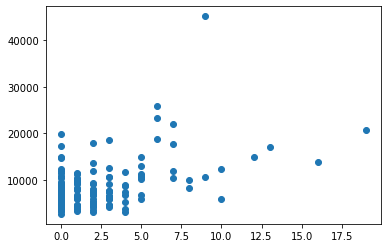

In [144]:
dfCluster3 = dfFinal[['Number_CoffeeShop','workingAgeIncome']]
plt.scatter(dfCluster3['Number_CoffeeShop'], dfCluster3['workingAgeIncome'])


In [145]:
km3 = KMeans(n_clusters = 3)
predicted3 = km3.fit_predict(dfCluster3)

dfCluster3['cluster'] = predicted3

scaler.fit(dfCluster3[['Number_CoffeeShop']])
scaler.fit(dfCluster3[['workingAgeIncome']])
dfCluster3['Number_CoffeeShop'] = abs(scaler.transform(dfCluster3[['Number_CoffeeShop']]))
dfCluster3['workingAgeIncome'] = scaler.transform(dfCluster3[['workingAgeIncome']])
dfCluster3


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/3870219424.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster3['cluster'] = predicted3
C:\Users\saash\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Number_CoffeeShop
Feature names seen at fit time, yet now missing:
- workingAgeIncome

  warnings.warn(message, FutureWarning)
C:\Users\saash\AppData\Local\Temp/ipykernel_15048/3870219424.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation:

,Number_CoffeeShop,workingAgeIncome,cluster
0,0.064904,0.042616,0
1,0.064644,0.290166,1
2,0.064927,0.042970,0
3,0.064927,0.080628,0
4,0.064880,0.073663,0
...,...,...,...
135,0.064762,0.182623,0
136,0.064927,0.053831,0
137,0.064904,0.087239,0
138,0.064857,0.111675,0


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/62134360.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster3['hood'] = dfFinal['Neighbourhood_ID']


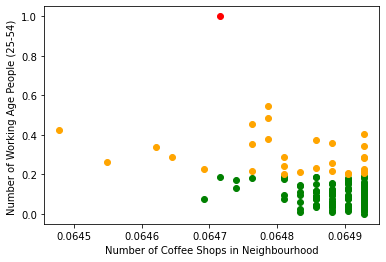

In [146]:
df1Cluster3 = dfCluster3[dfCluster3.cluster == 0]
df2Cluster3 = dfCluster3[dfCluster3.cluster == 1]
df3Cluster3 = dfCluster3[dfCluster3.cluster == 2]


plt.scatter(df1Cluster3['Number_CoffeeShop'],df1Cluster3.workingAgeIncome, color = 'green')
plt.scatter(df2Cluster3['Number_CoffeeShop'],df2Cluster3.workingAgeIncome, color = 'orange')
plt.scatter(df3Cluster3['Number_CoffeeShop'],df3Cluster3.workingAgeIncome, color = 'red')

plt.xlabel('Number of Coffee Shops in Neighbourhood')
plt.ylabel('Number of Working Age People (25-54) ')

dfCluster3['hood'] = dfFinal['Neighbourhood_ID']

# CLUSTER 4

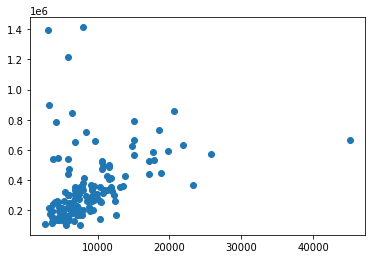

In [147]:
dfCluster4 = dfFinal[['workingAgeIncome','avgIncomeHousehold']]

plt.scatter(dfCluster4['workingAgeIncome'], dfCluster4['avgIncomeHousehold'])

In [148]:
km3 = KMeans(n_clusters = 3)
predicted4 = km3.fit_predict(dfCluster4)

dfCluster4['cluster'] = predicted4

scaler.fit(dfCluster4[['workingAgeIncome']])
scaler.fit(dfCluster4[['avgIncomeHousehold']])
dfCluster4['workingAgeIncome'] = abs(scaler.transform(dfCluster4[['workingAgeIncome']]))
dfCluster4['avgIncomeHousehold'] = scaler.transform(dfCluster4[['avgIncomeHousehold']])
dfCluster4


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/1412543879.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster4['cluster'] = predicted4
C:\Users\saash\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- workingAgeIncome
Feature names seen at fit time, yet now missing:
- avgIncomeHousehold

  warnings.warn(message, FutureWarning)
C:\Users\saash\AppData\Local\Temp/ipykernel_15048/1412543879.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation

,workingAgeIncome,avgIncomeHousehold,cluster
0,0.074534,0.338003,2
1,0.066535,0.526556,2
2,0.074522,0.023358,0
3,0.073305,0.105283,0
4,0.073530,0.850064,1
...,...,...,...
135,0.070010,0.113830,0
136,0.074171,0.086108,0
137,0.073092,0.062706,0
138,0.072302,0.130239,0


C:\Users\saash\AppData\Local\Temp/ipykernel_15048/2037679802.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCluster4['hood'] = dfFinal['Neighbourhood_ID']


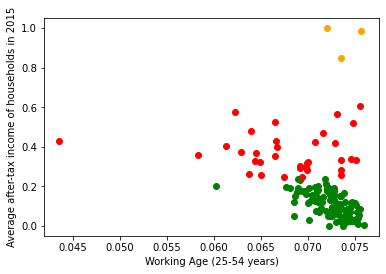

In [149]:
df1Cluster4 = dfCluster4[dfCluster4.cluster == 0]
df2Cluster4 = dfCluster4[dfCluster4.cluster == 1]
df3Cluster4 = dfCluster4[dfCluster4.cluster == 2]


plt.scatter(df1Cluster4['workingAgeIncome'],df1Cluster4['avgIncomeHousehold'], color = 'green')
plt.scatter(df2Cluster4['workingAgeIncome'],df2Cluster4['avgIncomeHousehold'], color = 'orange')
plt.scatter(df3Cluster4['workingAgeIncome'],df3Cluster4['avgIncomeHousehold'], color = 'red')

plt.xlabel('Working Age (25-54 years)')
plt.ylabel('Average after-tax income of households in 2015')

dfCluster4['hood'] = dfFinal['Neighbourhood_ID']

In [150]:
secondmap = folium.GeoJson(geoJSON, name="geojson")
cluster1HeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='shops v.s crime', 
    columns = ['hood', 'cluster'],
    data=dfCluster1,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='YlOrRd',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "shops v.s crime"
)

cluster2HeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='shops v.s income', 
    columns = ['hood', 'cluster'],
    data=dfCluster2,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='RdYlBu',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "shops v.s income"
)

cluster3HeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='shops v.s age', 
    columns = ['hood', 'cluster'],
    data=dfCluster3,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='Blues',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "shops v.s age"
)

cluster4HeatMap = folium.Choropleth(
    geo_data=geoJSON,
    name ='age v.s income', 
    columns = ['hood', 'cluster'],
    data=dfCluster4,
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color ='Spectral',     
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "age v.s income"
)






m2 = folium.Map(location=[43.6532, -79.3832],
           zoom_start=12,           
           attr='My Data Attribution').add_child(secondmap).add_child(cluster1HeatMap).add_child(cluster2HeatMap).add_child(cluster3HeatMap).add_child(cluster4HeatMap).add_child(folium.LayerControl())

marker(starbucksList,m2)
marker(starbucksList2,m2)
marker(starbucksList3,m2)
marker(starbucksList4,m2)
marker2(timhortonsList,m2)
marker2(timhortonsList2,m2)
marker2(timhortonsList3,m2)
marker2(timhortonsList4,m2)


m2


